# Imports

In [26]:
import pandas as pd
import numpy as np
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt

pd.set_option('display.max_columns', None)

In [27]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE 

In [28]:
df_rfm = pd.read_csv("data/merged_datasets/rfm.csv", index_col="customer_unique_id")
df_complete = pd.read_csv("data/merged_datasets/complete_customer_info.csv", index_col="customer_unique_id")

# RFM

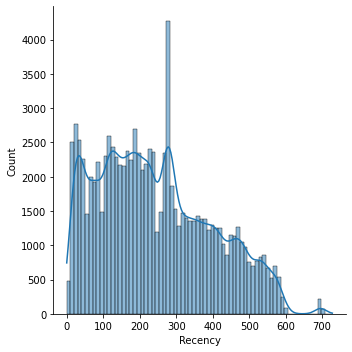

In [29]:
sns.displot(df_rfm["Recency"], kde=True)

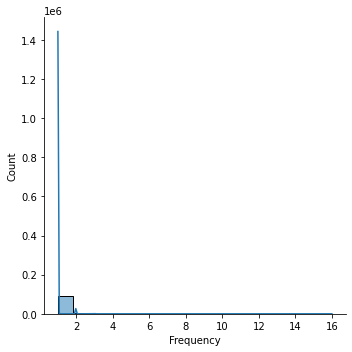

In [30]:
sns.displot(df_rfm["Frequency"], kde=True)


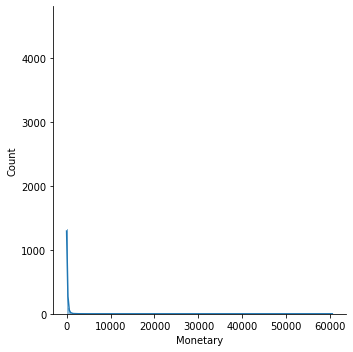

In [31]:
sns.displot(df_rfm["Monetary"], kde=True)

In [32]:
df_rfm

,Monetary,Recency,Frequency
customer_unique_id,,,
0000366f3b9a7992bf8c76cfdf3221e2,129.90,115,1
0000b849f77a49e4a4ce2b2a4ca5be3f,18.90,118,1
0000f46a3911fa3c0805444483337064,69.00,541,1
0000f6ccb0745a6a4b88665a16c9f078,25.99,325,1
0004aac84e0df4da2b147fca70cf8255,180.00,292,1
...,...,...,...
fffcf5a5ff07b0908bd4e2dbc735a684,2250.00,451,1
fffea47cd6d3cc0a88bd621562a9d061,64.89,266,1
ffff371b4d645b6ecea244b27531430a,89.90,572,1


In [33]:
scaled_data = StandardScaler().fit_transform(df_rfm)

<AxesSubplot:>

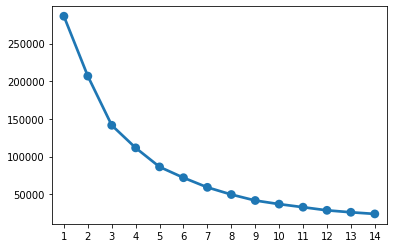

In [34]:
sum_of_sq_dist = {}
for k in range(1,15):
  km = KMeans(n_clusters=k, max_iter=1000).fit(scaled_data)
  sum_of_sq_dist[k] = km.inertia_
  
sns.pointplot(x=list(sum_of_sq_dist.keys()), y=list(sum_of_sq_dist.values()))

In [35]:
cluster = KMeans(n_clusters=3)
labels = cluster.fit_predict(scaled_data)

In [36]:
px.scatter_3d(df_rfm, x="Monetary", y="Recency", z="Frequency", color=labels).update_traces(marker_size=5).show()

In [37]:
raise
rfm_tsne = TSNE().fit_transform(X=scaled_data)

RuntimeError: No active exception to reraise

In [ ]:
px.scatter(x=rfm_tsne[:,0], y=rfm_tsne[:,1], color=labels, data_frame=df_rfm, hover_data=['Monetary', 'Recency', 'Frequency']).show()

# More complete KMeans

In [38]:
df_complete.columns

Index(['Monetary', 'Recency', 'Frequency', 'distance', 'deliver_time',
       'review_score'],
      dtype='object')

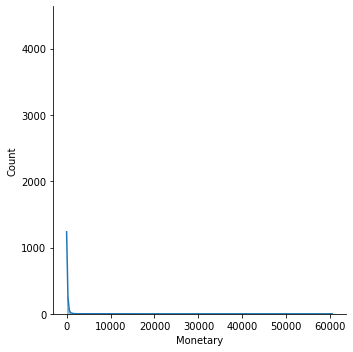

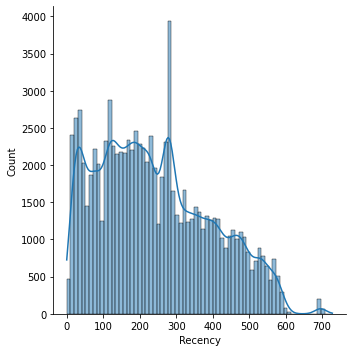

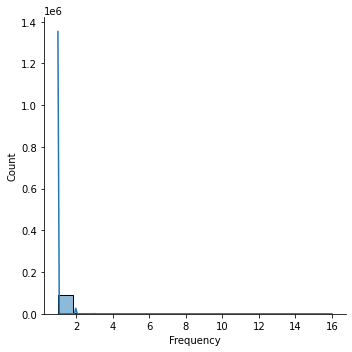

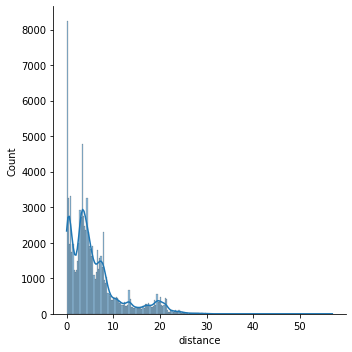

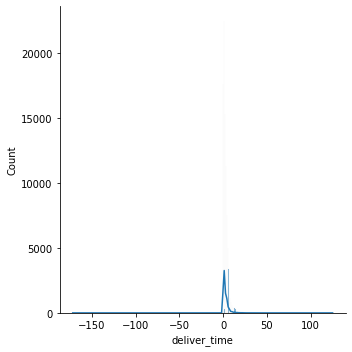

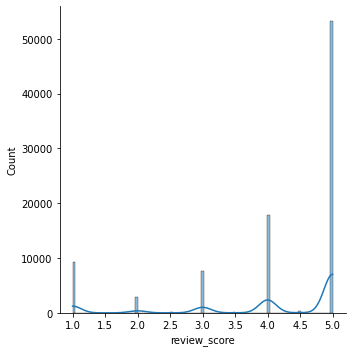

In [39]:
for column in df_complete.columns:
  sns.displot(df_complete[column], kde=True)

In [40]:
scaled_data = StandardScaler().fit_transform(df_complete)

<AxesSubplot:>

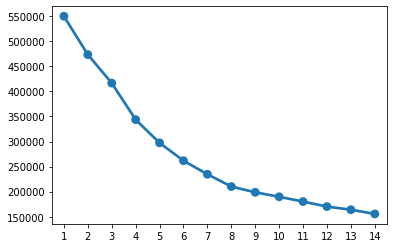

In [41]:
sum_of_sq_dist = {}
for k in range(1,15):
  km = KMeans(n_clusters=k).fit(scaled_data)
  sum_of_sq_dist[k] = km.inertia_
  
sns.pointplot(x=list(sum_of_sq_dist.keys()), y=list(sum_of_sq_dist.values()))

For n_clusters = 4 The average silhouette_score is : 0.254075775679148
For n_clusters = 5 The average silhouette_score is : 0.2795606463440803
For n_clusters = 6 The average silhouette_score is : 0.29570582050119476
For n_clusters = 7 The average silhouette_score is : 0.29679310581209467
For n_clusters = 8 The average silhouette_score is : 0.30332185132717243
For n_clusters = 9 The average silhouette_score is : 0.2903812781298703


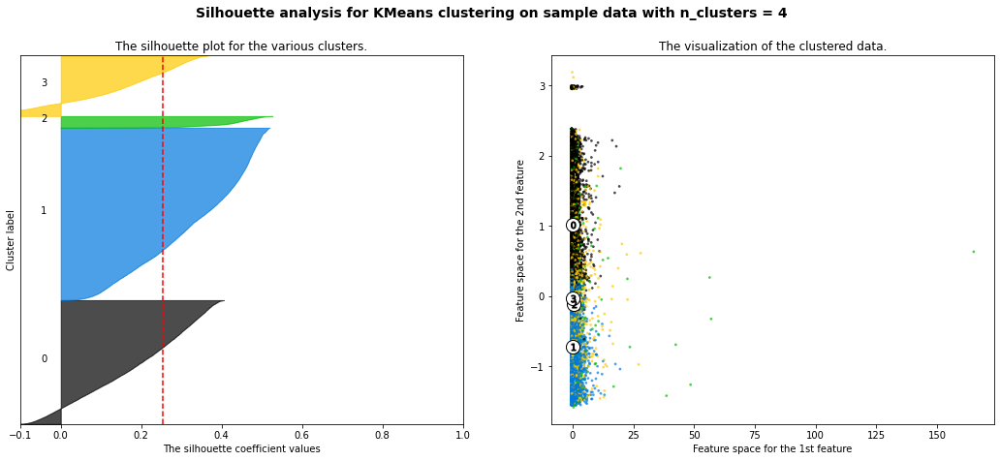

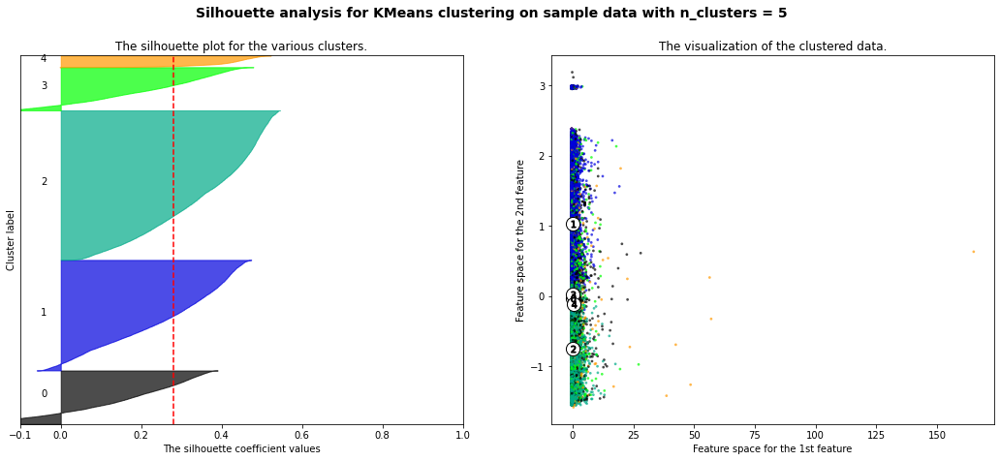

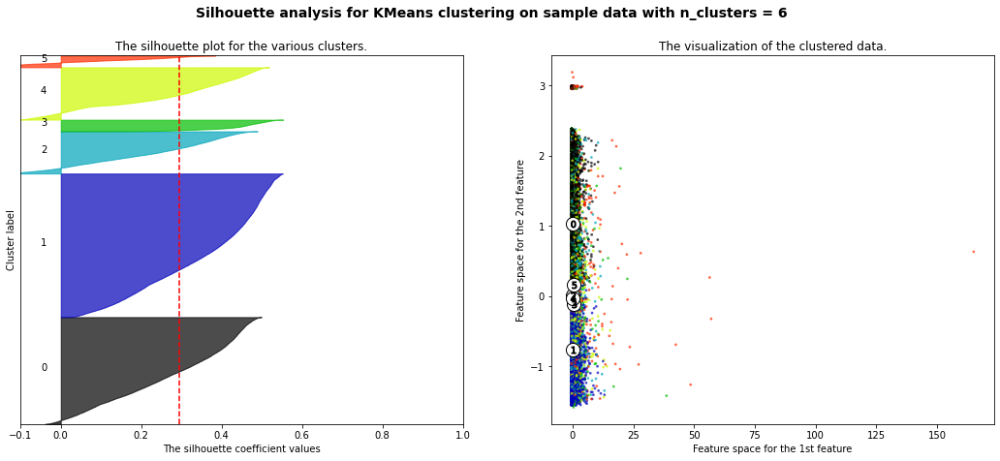

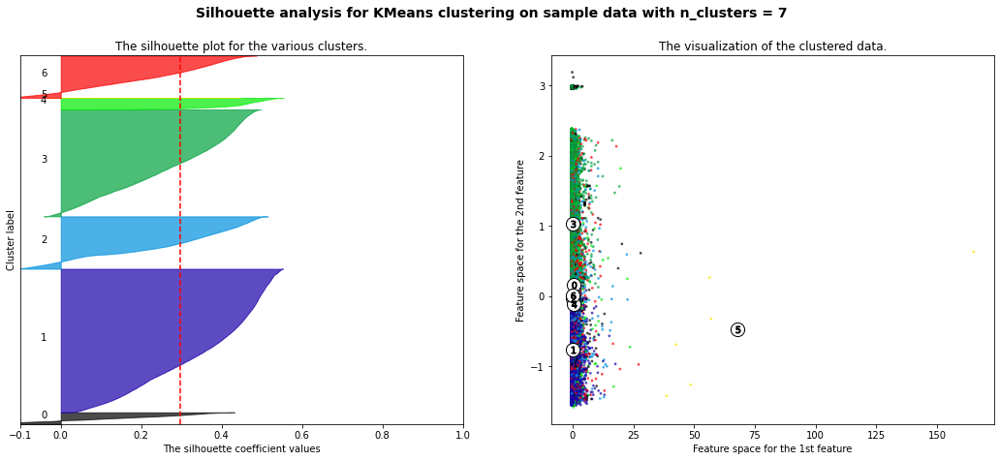

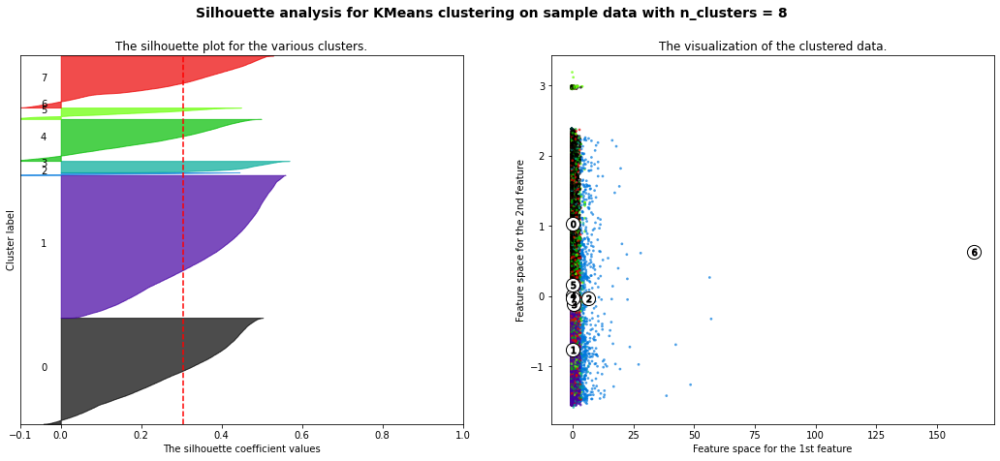

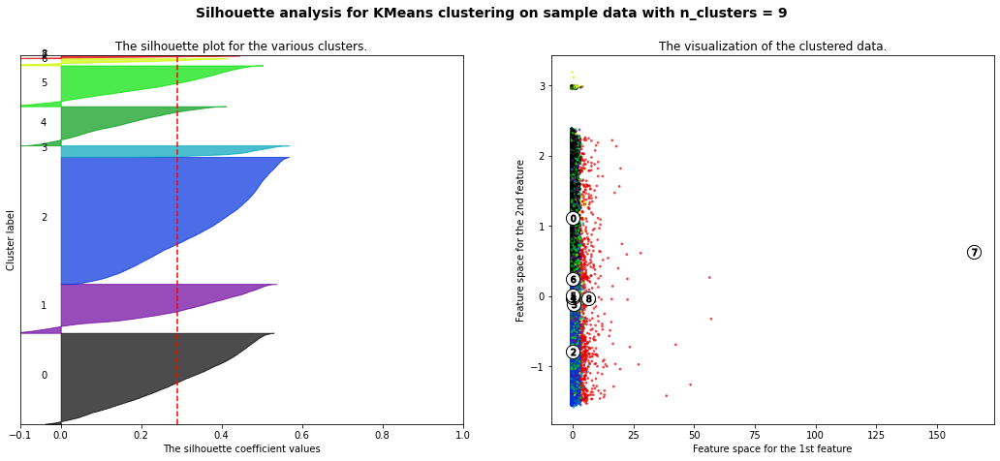

In [51]:
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np

X = scaled_data

range_n_clusters = [4, 5, 6, 7, 8, 9]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)#, sample_size=50)
    print(
        "For n_clusters =",
        n_clusters,
        "The average silhouette_score is :",
        silhouette_avg,
    )

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(
        X[:, 0], X[:, 1], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
    )

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(
        centers[:, 0],
        centers[:, 1],
        marker="o",
        c="white",
        alpha=1,
        s=200,
        edgecolor="k",
    )

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(
        "Silhouette analysis for KMeans clustering on sample data with n_clusters = %d"
        % n_clusters,
        fontsize=14,
        fontweight="bold",
    )

plt.show()

In [42]:
cluster = KMeans(n_clusters=8)
labels = cluster.fit_predict(scaled_data)

In [43]:
px.scatter_3d(df_complete, x="Monetary", y="Recency", z="Frequency", color=labels).update_traces(marker_size=5).show()

In [44]:
tsned = TSNE().fit_transform(X=scaled_data)

/Users/rom1/opt/anaconda3/envs/datascience/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/Users/rom1/opt/anaconda3/envs/datascience/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



In [49]:
fig = px.scatter(x=tsned[:,0], y=tsned[:,1], color=labels, data_frame=df_complete, hover_data=['Monetary', 'Recency', 'Frequency', 'distance', 'deliver_time', 'review_score'])
fig.show()

In [50]:
fig.write_html("visualisations/tsne.html")

In [72]:
for i in range(8):
  print("Cluster number {} ({} values)".format(i, df_complete[labels==i].shape[0]))
  # display(df_complete[labels == i])
  display(df_complete[labels==i].describe())

Cluster number 0 (26451 values)


,Monetary,Recency,Frequency,distance,deliver_time,review_score
count,26451.000000,26451.000000,26451.0,26451.000000,26451.000000,26451.00000
mean,127.455539,397.997467,1.0,4.247545,2.430834,4.64404
std,150.919763,94.002901,0.0,3.024104,2.183199,0.58947
min,2.290000,238.000000,1.0,0.000000,0.000000,2.00000
25%,44.990000,315.000000,1.0,1.780004,1.000000,4.00000
50%,79.990000,389.000000,1.0,3.869614,2.000000,5.00000
75%,149.700000,469.000000,1.0,6.445861,4.000000,5.00000
max,1420.000000,699.000000,1.0,16.809997,12.000000,5.00000


Cluster number 1 (2838 values)


,Monetary,Recency,Frequency,distance,deliver_time,review_score
count,2838.000000,2838.000000,2838.000000,2838.000000,2838.000000,2838.000000
mean,278.041942,224.233615,2.115222,5.462286,2.762040,4.164898
std,269.675410,143.851187,0.511869,4.915468,2.362008,1.098177
min,11.980000,0.000000,2.000000,0.000000,-0.500000,1.000000
25%,114.600000,109.000000,2.000000,2.245350,1.000000,3.500000
50%,194.995000,204.000000,2.000000,4.178954,2.000000,4.500000
75%,335.402500,321.000000,2.000000,6.969304,3.500000,5.000000
max,2528.500000,694.000000,16.000000,29.102654,18.000000,5.000000


Cluster number 2 (2823 values)


,Monetary,Recency,Frequency,distance,deliver_time,review_score
count,2823.000000,2823.000000,2823.000000,2823.000000,2823.000000,2823.000000
mean,207.736691,266.053843,1.004251,5.650939,16.660113,3.262841
std,255.485760,165.820685,0.065071,5.243463,7.599578,1.599408
min,3.900000,14.000000,1.000000,0.000000,9.000000,1.000000
25%,69.900000,152.000000,1.000000,1.816623,12.000000,1.000000
50%,129.960000,240.000000,1.000000,4.317382,14.000000,4.000000
75%,227.900000,339.000000,1.000000,7.653126,19.000000,5.000000
max,2139.990000,728.000000,2.000000,30.013232,125.000000,5.000000


Cluster number 3 (12955 values)


,Monetary,Recency,Frequency,distance,deliver_time,review_score
count,12955.000000,12955.000000,12955.0,12955.000000,12955.000000,12955.000000
mean,150.009843,235.745118,1.0,4.943856,2.769124,1.641625
std,177.806495,127.509025,0.0,3.715212,2.351313,0.834450
min,3.540000,4.000000,1.0,0.000000,-1.000000,1.000000
25%,49.000000,154.000000,1.0,2.579530,1.000000,1.000000
50%,92.890000,216.000000,1.0,4.283936,2.000000,1.000000
75%,175.000000,294.000000,1.0,7.027415,4.000000,2.000000
max,1439.400000,698.000000,1.0,18.500931,11.000000,3.000000


Cluster number 4 (35520 values)


,Monetary,Recency,Frequency,distance,deliver_time,review_score
count,35520.000000,35520.000000,35520.0,35520.000000,35520.000000,35520.000000
mean,127.047893,125.929448,1.0,3.755330,1.910952,4.696931
std,149.817378,72.995499,0.0,2.898880,2.141095,0.537141
min,0.850000,4.000000,1.0,0.000000,-172.000000,3.000000
25%,44.900000,63.000000,1.0,1.078423,1.000000,4.000000
50%,83.990000,123.000000,1.0,3.413118,1.000000,5.000000
75%,149.000000,187.000000,1.0,5.647595,3.000000,5.000000
max,1399.000000,275.000000,1.0,13.170398,11.000000,5.000000


Cluster number 5 (10427 values)


,Monetary,Recency,Frequency,distance,deliver_time,review_score
count,10427.00000,10427.000000,10427.0,10427.000000,10427.000000,10427.000000
mean,159.45683,243.609092,1.0,17.956019,2.448835,4.216122
std,192.22516,145.689149,0.0,3.900585,2.307201,1.152326
min,4.90000,7.000000,1.0,10.030413,-1.000000,1.000000
25%,49.99000,127.000000,1.0,14.714383,1.000000,4.000000
50%,99.90000,229.000000,1.0,18.508404,2.000000,5.000000
75%,179.20000,343.500000,1.0,20.392474,4.000000,5.000000
max,1499.90000,698.000000,1.0,56.976814,14.000000,5.000000


Cluster number 6 (1 values)


,Monetary,Recency,Frequency,distance,deliver_time,review_score
count,1.0,1.0,1.0,1.000000,1.0,1.0
mean,60480.0,338.0,1.0,3.413118,11.0,1.0
std,NaN,NaN,NaN,NaN,NaN,NaN
min,60480.0,338.0,1.0,3.413118,11.0,1.0
25%,60480.0,338.0,1.0,3.413118,11.0,1.0
50%,60480.0,338.0,1.0,3.413118,11.0,1.0
75%,60480.0,338.0,1.0,3.413118,11.0,1.0
max,60480.0,338.0,1.0,3.413118,11.0,1.0


Cluster number 7 (666 values)


,Monetary,Recency,Frequency,distance,deliver_time,review_score
count,666.000000,666.000000,666.000000,666.000000,666.000000,666.000000
mean,2506.369264,236.436937,1.049550,6.923574,3.924424,3.772773
std,1834.533673,153.202298,0.249405,6.125317,4.151441,1.549545
min,1330.000000,8.000000,1.000000,0.000000,0.000000,1.000000
25%,1654.020000,111.250000,1.000000,2.691674,1.000000,3.000000
50%,1999.000000,215.000000,1.000000,4.755314,3.000000,4.500000
75%,2695.250000,337.750000,1.000000,9.485857,5.000000,5.000000
max,21000.000000,586.000000,4.000000,28.003982,26.000000,5.000000
